# Dataset explorer
Pandora dataset: https://drive.google.com/drive/folders/1iDm1Mh43okcjRNFHdk1qZXAmpipoY2KN <br>
AFLW2000 dataset: http://www.cbsr.ia.ac.cn/users/xiangyuzhu/projects/3DDFA/Database/AFLW2000-3D.zip <br>
Additional material: https://drive.google.com/drive/folders/1WfEClS251URijGgQbjJLGL5lfBIuFhvM

In [2]:
import os
import json
import cv2
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.cm import ScalarMappable
from tqdm import tqdm
from numpy.linalg import inv
from facenet_pytorch import MTCNN
from PIL import Image
import torch
from scipy.spatial.transform import Rotation as R
import scipy
import random
import utils
import plotly.graph_objects as go
%matplotlib widget

## Pandora

#### Plot sample

In [ ]:
frame = "000340"
subject = "04"
folder_path = "/home/spoleto/hpe/dataset/pandora/" + subject + "/free_1_ID" + subject
# Read the json file "data.json" from the folder
data = None
with open(os.path.join(folder_path, "data.json")) as json_file:
    data = json.load(json_file)
    # First element of the json
    print("Euler angles: ", data[int(frame)]["orientation"]["euler"])
    print("Quaternions: ", data[int(frame)]["orientation"]["quaternion"])
    # yaw - roll -pitch

# Using opencv read the rgb and depth image from the respective subfolders of the folder path
rgb_image = Image.open(os.path.join(folder_path, "RGB",  frame + "_RGB.png")).convert("RGB")
# Read the depth image as grayscale 16 bit
depth_image = Image.open(os.path.join(folder_path, "DEPTH",  frame + "_DEPTH.png"))

# Create subplots
fig, (ax1, ax2) = plt.subplots(1, 2)

# Show the images
ax1.imshow(rgb_image)
ax1.axis("off")
ax1.set_title(f"RGB {rgb_image.size} {rgb_image.mode}")

plt.set_cmap("binary")
ax2.imshow(depth_image)
ax2.axis("off")
ax2.set_title(f"Depth {depth_image.size} {depth_image.mode}")

plt.show()

# Face detection
mtcnn = MTCNN(margin=40, image_size=100, select_largest=False, post_process=False, device='cuda')
rgb_face_image = mtcnn(rgb_image)
rgb_face_image = rgb_face_image.permute(1, 2, 0).int()

# Convert to BGR and save it to disk with opencv
plt.imshow(rgb_face_image)
plt.show()

### Alignment

#### Depth registration routine

In [ ]:
def registerDepth(intrinsics_depth, intrinsics_color, extrinsics, depth, shape):

    # Extract the width and height from the 'shape' parameter, which represents the dimensions of the output image.
    width, height = shape

    # Initialize an output numpy array called 'out' with zeros. This array has the same dimensions as the output image.
    aligned_image = np.zeros((height, width))

    # Generate coordinate grids 'x' and 'y' covering the entire depth image.
    y, x = np.meshgrid(np.arange(depth.shape[0]), np.arange(depth.shape[1]), indexing='ij')
    x = x.reshape(1, -1) # Reshape the coordinate grids to be vectors.
    y = y.reshape(1, -1) # Reshape the coordinate grids to be vectors.
    z = depth.reshape(1, -1) # Extract the depth values as 'z'.

    depth_pts = np.vstack((x*z, y*z, z))

    pts = inv(intrinsics_depth) @ depth_pts

    # # Normalize 'x' and 'y' based on the intrinsic parameters of the depth camera ('intrinsics_depth').
    # x = (x - intrinsics_depth[0, 2]) / intrinsics_depth[0, 0]
    # y = (y - intrinsics_depth[1, 2]) / intrinsics_depth[1, 1]

    # # Transform the coordinates and depth values to obtain 3D points in the depth camera's coordinate system.
    # pts = np.vstack((x * z, y * z, z))

    # Apply the extrinsic transformation ('extrinsics') to convert 3D points from the depth camera's coordinate system
    # to the color camera's coordinate system.
    pts = extrinsics[:3, :3] @ pts + extrinsics[:3, 3:]

    # Project the 3D points onto the 2D image plane of the color camera using its intrinsic parameters ('intrinsics_color').
    pts = intrinsics_color @ pts

    # Round the x and y coordinates of the projected points to obtain pixel coordinates.
    px = np.round(pts[0, :] / pts[2, :])
    py = np.round(pts[1, :] / pts[2, :])

    # Create a mask to check if the pixel coordinates are within the valid image boundaries.
    mask = (px >= 0) * (py >= 0) * (px < width) * (py < height)

    # Assign the depth value to the corresponding pixel locations in the 'out' array. This step registers the depth data
    # to the color camera's perspective.
    aligned_image[py[mask].astype(int), px[mask].astype(int)] = pts[2, mask]

    # Return the registered depth data as the 'out' array.
    return aligned_image

#### Intrinsic / Extrinsic parameters

In [ ]:
# TIZIO
# Depth Camera Parameters
cx_d = 256.684
cy_d = 207.085
fx_d = 366.193
fy_d = 366.193
k1_d = 0.0893804
k2_d = -0.272566
p1_d = 0
p2_d = 0
k3_d = 0.0958438

# RGB Camera Parameters
cx_rgb = 959.5
cy_rgb = 539.5
fx_rgb = 1081.37
fy_rgb = 1081.37
k1_rgb = 2.0429028189430772e-02
k2_rgb = -7.8399448855923665e-03
p1_rgb = -3.0949667668667908e-03
p2_rgb = 2.1848647826377197e-03
k3_rgb = -5.2344198896187882e-02

# Relative Transform
R = np.array([
    [0.99997, 0.00715, -0.00105],
    [-0.00715, 0.99995,  0.00662],
    [0.00110, -0.00661, 0.99998]])
T = np.array([-0.06015, 0.00221, 0.02714])

Rt = np.eye(4)
Rt[:3, :3] = R
Rt[:3, 3] = T

# Depth Camera Parameters
depth_camera_matrix = np.array([
    [fx_d, 0, cx_d],
    [0, fy_d, cy_d],
    [0, 0, 1]
])
depth_distortion_coefficients = np.array([k1_d, k2_d, p1_d, p2_d, k3_d])

# RGB Camera Parameters
rgb_camera_matrix = np.array([
    [fx_rgb, 0, cx_rgb],
    [0, fy_rgb, cy_rgb],
    [0, 0, 1]
])

rgb_distortion_coefficients = np.array([k1_rgb, k2_rgb, p1_rgb, p2_rgb, k3_rgb])

In [ ]:
# PAPER
# Depth Camera Parameters
fx_d = 388.198
fy_d = 389.033
cx_d = 253.270
cy_d = 213.934
k1_d = 0.126
k2_d = -0.329
p1_d = -0.001
p2_d = -0.002
k3_d = 0.111 

# RGB Camera Parameters
fx_rgb = 1144.361
fy_rgb = 1147.337
cx_rgb = 966.359
cy_rgb = 548.038
k1_rgb = 0.108
k2_rgb = -0.125
p1_rgb = -0.001
p2_rgb = -0.003
k3_rgb = 0.062

# Relative Transform
R = np.array([
    [0.99997, 0.00715, -0.00105],
    [-0.00715, 0.99995,  0.00662],
    [0.00110, -0.00661, 0.99998]])
T = np.array([0.06015, -0.00221, -0.02714])

Rt = np.eye(4)
Rt[:3, :3] = R
Rt[:3, 3] = T

# Depth Camera Parameters
depth_camera_matrix = np.array([
    [fx_d, 0, cx_d],
    [0, fy_d, cy_d],
    [0, 0, 1]
])
depth_distortion_coefficients = np.array([k1_d, k2_d, p1_d, p2_d, k3_d])

# RGB Camera Parameters
rgb_camera_matrix = np.array([
    [fx_rgb, 0, cx_rgb],
    [0, fy_rgb, cy_rgb],
    [0, 0, 1]
])

rgb_distortion_coefficients = np.array([k1_rgb, k2_rgb, p1_rgb, p2_rgb, k3_rgb])

### Repair labels

In [ ]:
pbar = tqdm(os.listdir("dataset/pandora"))
for folder in pbar:
    for subfolder in os.listdir("dataset/pandora/" + folder):
        pbar.set_description("Processing %s %s" % (folder, subfolder))
        with open("dataset/pandora/" + folder + "/" + subfolder + "/data.json") as f:
            json_file = json.load(f)
            for row in json_file:
                frame_num = row["frame_num"]
                angles = row["orientation"]["euler"]

                image_name = "000000"
                image_name = image_name[:-len(str(frame_num))] + str(frame_num) + ".png"
                image_path = "dataset/pandora/" + folder + "/" + subfolder + "/faces/" + image_name

In [ ]:
ID = "22"
json_file = "/home/spoleto/hpe/dataset/pandora/"+ID+"/free_1_ID"+ID+"/data.json"
new_labels = []

with open(json_file) as f:
    data = json.load(f)
    for key in data.keys():
        dictionary = data[key]
        # Convert str to dict
        dictionary = json.loads(dictionary)
        new_labels.append(dictionary)

# Rename the current json file to data.json.bak
os.rename(json_file, json_file + ".bak")

# Write the labels to json
with open(json_file, 'w') as outfile:
    json.dump(new_labels, outfile)

### Filter out false positive faces

#### Detect images with less than 0.3 confidence

In [ ]:
from IPython.display import display, clear_output
mean = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/mean.pt")
std = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/std.pt")

mtcnn = MTCNN(select_largest=True, post_process=False, device='cuda:0', thresholds=[0.3, 0.3, 0.3])

# Create a plot
fig, ax = plt.subplots(1, 1)

for num in tqdm(range(0, 138591)):

    # Load the tensors
    face = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + str(num) + ".pt")
    # Convert face to opencv
    face = face.permute(1, 2, 0)
    face = face * std + mean
    face = face.int()
    face = face.numpy()
    face = face.astype(np.uint8)
    # Convert to grayscale
    boxes, _ = mtcnn.detect(face)

    if boxes is None:
        print(f"Sample:{num} - No face detected")
        ax.imshow(face)
        display(fig)
        clear_output(wait=True)
        input()

# 2224, 2257, 2386, 2402, 9089, 12426, 12427, 13398, 13418, 31244, 32183, 32228, 43588, 53361, 54889, 55664, 56776, 56777
# 56778, 56779, 57686, 57700, 57700, 60489, 61037, 61261, 61563, 62268, 69801, 74537, 74837, 74842, 75235, 77196, 81461
# 81536, 81537, 81538, 82885, 84742, 86019, 99890, 100230, 116879, 119358, 133677
        

#### Remove these samples

In [ ]:
samples_to_remove = [2224, 2257, 2386, 2402, 9089, 12426, 12427, 13398, 13418, 31244, 32183, 32228, 43588, 53361, 54889, 55664, 56776, 56777, 56778, 56779, 57686, 57700, 57700, 60489, 61037, 61261, 61563, 62268, 69801, 74537, 74837, 74842, 75235, 77196, 81461, 81536, 81537, 81538, 82885, 84742, 86019, 99890, 100230, 109555, 116879, 119358, 133677, 134311]

for num in tqdm(samples_to_remove):
    if os.path.isfile("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + str(num) + ".pt"):
        os.remove("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + str(num) + ".pt")
    if os.path.isfile("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/" + str(num) + ".pt"):
        os.remove("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/" + str(num) + ".pt")
    if os.path.isfile("/home/spoleto/hpe/serialized_dataset/pandora/labels/quaternion/" + str(num) + ".pt"):
        os.remove("/home/spoleto/hpe/serialized_dataset/pandora/labels/quaternion/" + str(num) + ".pt")
    if os.path.isfile("/home/spoleto/hpe/serialized_dataset/pandora/labels/rotation_matrix/" + str(num) + ".pt"):
        os.remove("/home/spoleto/hpe/serialized_dataset/pandora/labels/rotation_matrix/" + str(num) + ".pt")
    if os.path.isfile("/home/spoleto/hpe/serialized_dataset/pandora/labels/classes/" + str(num) + ".pt"):
        os.remove("/home/spoleto/hpe/serialized_dataset/pandora/labels/classes/" + str(num) + ".pt")

### Plot statistics


Load euler labels

In [ ]:
roll = []
pitch = []
yaw = []
file_id = []

for file in tqdm(os.listdir("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/")):
    labels = torch.load(os.path.join("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/", file))
    roll.append(labels[0])
    yaw.append(labels[1])
    pitch.append(labels[2])
    file_id.append(file)

produce histograms for each of the angles

In [ ]:
roll_angles = torch.cat(roll).numpy()
yaw_angles = torch.cat(yaw).numpy()
pitch_angles = torch.cat(pitch).numpy()

all_angles = {"Roll":roll_angles, "Yaw":yaw_angles, "Pitch":pitch_angles}

fig, axes = plt.subplots(1, 3, figsize=(25, 5))

# Define bin edges
bin_edges = np.arange(-130, 130, 10)

# Create a colormap
cmap = plt.cm.viridis  # You can choose any other colormap

# Create ScalarMappable for colormap scaling
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(0, 1))
sm.set_array([])

# Create histogram using numpy
for index, key in enumerate(all_angles.keys()):
    angles = all_angles[key]

    hist, _ = np.histogram(angles, bins=bin_edges)

    # Normalize heights to [0, 1] for colormap
    norm_hist = hist / hist.max()

    # Plot the histogram with colored bins
    ax = axes[index]
    ax.bar(bin_edges[:-1], hist, width=10, align='edge', color=cmap(norm_hist), edgecolor='black')

    # Add colorbar
    cbar = plt.colorbar(sm, ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label('Normalized Frequency')
    ax.set_xlabel('Angles')
    ax.set_ylabel('Frequency')
    ax.set_title(key)
    ax.set_xticks(np.arange(-130, 130, 20))

# Show the plot
plt.show()


In [ ]:
# Find a pitch angle from -70 to 70 with a step of 10
pitch_indices = {"first":[], "second":[], "third":[], "fourth":[], "fifth":[], "sixth":[], "seventh":[]}

for idx, pitch_value in enumerate(pitch_angles):
    if pitch_value >= -70 and pitch_value <= -50:
        pitch_indices["first"].append(idx)
    elif pitch_value >= -50 and pitch_value <= -30:
        pitch_indices["second"].append(idx)
    elif pitch_value >= -30 and pitch_value <= -10:
        pitch_indices["third"].append(idx)
    elif pitch_value >= -10 and pitch_value <= 10:
        pitch_indices["fourth"].append(idx)
    elif pitch_value >= 10 and pitch_value <= 30:
        pitch_indices["fifth"].append(idx)
    elif pitch_value >= 30 and pitch_value <= 50:
        pitch_indices["sixth"].append(idx)
    elif pitch_value >= 50 and pitch_value <= 70:
        pitch_indices["seventh"].append(idx)

# Find a roll angle from -70 to 70 with a step of 10
roll_indices = {"first":[], "second":[], "third":[], "fourth":[], "fifth":[], "sixth":[], "seventh":[]}

for idx, roll_value in enumerate(roll_angles):
    if roll_value >= -70 and roll_value <= -50:
        roll_indices["first"].append(idx)
    elif roll_value >= -50 and roll_value <= -30:
        roll_indices["second"].append(idx)
    elif roll_value >= -30 and roll_value <= -10:
        roll_indices["third"].append(idx)
    elif roll_value >= -10 and roll_value <= 10:
        roll_indices["fourth"].append(idx)
    elif roll_value >= 10 and roll_value <= 30:
        roll_indices["fifth"].append(idx)
    elif roll_value >= 30 and roll_value <= 50:
        roll_indices["sixth"].append(idx)
    elif roll_value >= 50 and roll_value <= 70:
        roll_indices["seventh"].append(idx)

# Find a yaw angle from -70 to 70 with a step of 10
yaw_indices = {"first":[], "second":[], "third":[], "fourth":[], "fifth":[], "sixth":[], "seventh":[]}

for idx, yaw_value in enumerate(yaw_angles):
    if yaw_value >= -70 and yaw_value <= -50:
        yaw_indices["first"].append(idx)
    elif yaw_value >= -50 and yaw_value <= -30:
        yaw_indices["second"].append(idx)
    elif yaw_value >= -30 and yaw_value <= -10:
        yaw_indices["third"].append(idx)
    elif yaw_value >= -10 and yaw_value <= 10:
        yaw_indices["fourth"].append(idx)
    elif yaw_value >= 10 and yaw_value <= 30:
        yaw_indices["fifth"].append(idx)
    elif yaw_value >= 30 and yaw_value <= 50:
        yaw_indices["sixth"].append(idx)
    elif yaw_value >= 50 and yaw_value <= 70:
        yaw_indices["seventh"].append(idx)

In [ ]:
# Load dataset mean and std
mean = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/mean.pt")
std = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/std.pt")

positions = ["first", "second", "third", "fourth", "fifth", "sixth", "seventh"]
fig, axes = plt.subplots(3, len(positions), figsize=(25, 10))

sample = 303

for index, position in enumerate(positions):
    file_name = file_id[roll_indices[position][sample]]

    face = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + file_name)
    euler = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/" + file_name)

    face = face.permute(1, 2, 0)
    face = face * std + mean
    face = face.int()

    ax = axes[0, index]

    ax.imshow(face)
    ax.set_title("Roll: " + position)

    file_name = file_id[yaw_indices[position][sample]]

    face = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + file_name)
    euler = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/" + file_name)

    face = face.permute(1, 2, 0)
    face = face * std + mean
    face = face.int()

    ax = axes[1, index]

    ax.imshow(face)
    ax.set_title("Yaw: " + position)

    file_name = file_id[pitch_indices[position][sample]]

    face = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + file_name)
    euler = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/" + file_name)

    face = face.permute(1, 2, 0)
    face = face * std + mean
    face = face.int()

    ax = axes[2, index]

    ax.imshow(face)
    ax.set_title("Pitch: " + position)

plt.show()


### Inspect data randomly from the serialized dataset


Image number: 66744
Euler angles:  tensor([[-179.2437],
        [ -76.7276],
        [ 175.7822]])
Rotation matrix:  tensor([[-0.2290,  0.9696, -0.0864],
        [-0.9733, -0.2296,  0.0030],
        [-0.0169,  0.0847,  0.9963]])


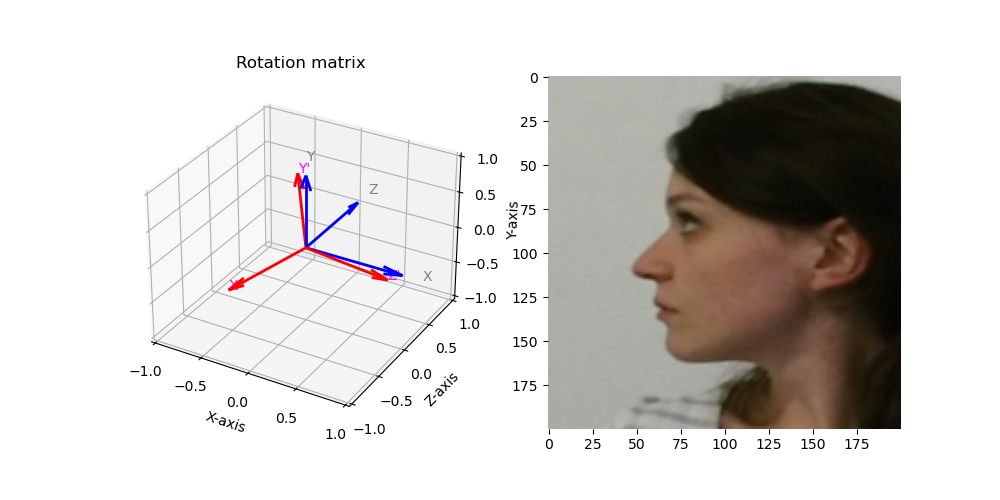

In [38]:
# Load dataset mean and std
mean = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/mean.pt")
std = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/std.pt")

# random number from 0 to 1000
num = np.random.randint(0, 138591)
num = 66744
print("Image number:", num)
# Load the tensors
face = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/faces/" + str(num) + ".pt")
euler = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/labels/euler/" + str(num) + ".pt")
rotation_matrix = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/labels/rotation_matrix/" + str(num) + ".pt")

print("Euler angles: ", euler)
print("Rotation matrix: ", rotation_matrix)

fig = plt.figure(0, figsize=(10, 5))

#euler_array = euler.squeeze().numpy()
#print("Euler angles array: ", euler_array)
# per scipy z va verso l'alto, quindi z = yaw, x = pitch, y = roll
# quindi in questo caso, dal momento che il dataset è roll, yaw, pitch, diventa yzx
#rotation_matrix = R.from_euler('yzx', euler_array, degrees=True).as_matrix()

# Make the face drawable
face = face.permute(1, 2, 0)
face = face * std + mean
face = face.int()
face = face.numpy()

utils.plot_rotation_3D(fig, rotation_matrix)
#face = draw_axes(face, rotation_matrix)
# Add a second subplot with no frame and show the face
ax2 = fig.add_subplot(122, frameon=False)
ax2.imshow(face)

plt.show()

## AIWatch

### Filter out wrongly labelled data

In [ ]:
import re
# to delete: 114, 118, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 109
color_path = "/home/spoleto/hpe/dataset/AIWatch/Color_filtered/"
depth_path = "/home/spoleto/hpe/dataset/AIWatch/Depth_filtered/"
depth_c_path = "/home/spoleto/hpe/dataset/AIWatch/Depth_c_filtered/"
angles_path = "/home/spoleto/hpe/dataset/AIWatch/Angles/"

paths = [color_path, depth_path, depth_c_path, angles_path]

numbers_to_delete = [114, 118, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 109, ]

for path in paths:
    for file in tqdm(os.listdir(path)):
        # If file is not a dir
        if os.path.isdir(os.path.join(path, file)):
            continue
        # Extract the number from the file name
        num = re.findall(r'\d+', file)
        
        if int(num[0]) in numbers_to_delete:
            print(os.path.join(path, file))
            os.remove(os.path.join(path, file))


### Plot random sample

In [ ]:
# Use os to get all files in a specific folder
images = os.listdir("/home/spoleto/hpe/dataset/AIWatch/Color_filtered")
images_paths = [os.path.join("/home/spoleto/hpe/dataset/AIWatch/Color_filtered", image) for image in images]
images_paths = sorted(images_paths)

labels = os.listdir("/home/spoleto/hpe/dataset/AIWatch/Angles")
labels_paths = [os.path.join("/home/spoleto/hpe/dataset/AIWatch/Angles", label) for label in labels]
labels_paths = sorted(labels_paths)

sample_num = random.randint(0, len(images_paths))
sample_num = 26

print(sample_num)
sample_image_path = images_paths[sample_num]
sample_label_path = labels_paths[sample_num]
label = None

with open(sample_label_path) as f:
    angles = f.read().split(" ")
    angles = [float(angle) for angle in angles]
    label = torch.tensor(utils.convert_angles_from_AIWatch(angles))

print(sample_image_path)
print(sample_label_path)
print(label)

rotation_matrix = R.from_euler('xzy', label, degrees=True).as_matrix()

# Load the image with opencv
image = cv2.imread(sample_image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

#clear figure
plt.clf()
fig = plt.figure(2, figsize=(10, 5))
utils.plot_rotation_3D(fig, rotation_matrix)

ax2 = fig.add_subplot(122, frameon=False)
ax2.imshow(image)

plt.show()

# to delete: 114, 118, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 109, 130
# pitch yaw roll

### Inspect data randomly from serialized dataset

107
Image number: 69
Pitch: -50.000000237567605 - Yaw: -55.000000554650306 - Roll: 0.9999999664896646


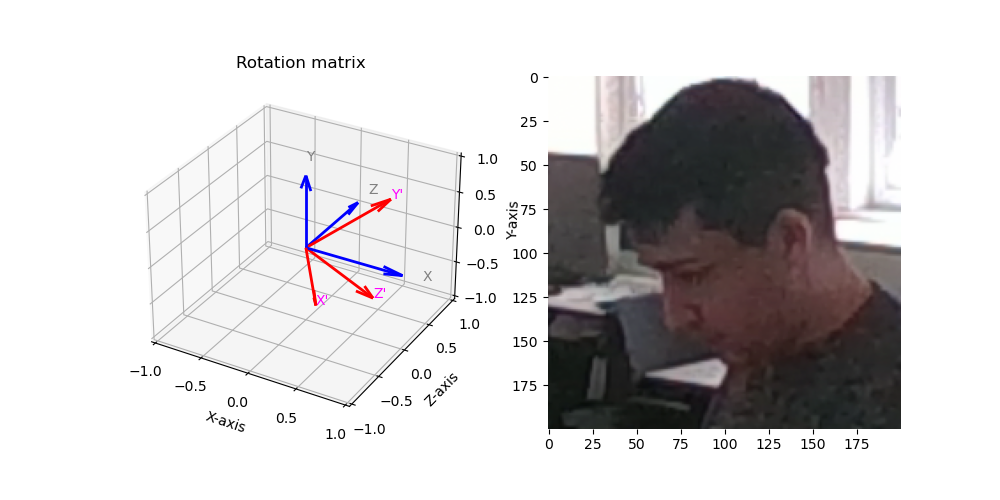

In [14]:
# Load dataset mean and std
mean = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/mean.pt")
std = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/std.pt")

num_files = len(os.listdir("/home/spoleto/hpe/serialized_dataset/AIWatch/faces/"))
print(num_files)
num = np.random.randint(0, num_files)
num = 69
print("Image number:", num)
# Load the tensors
face = torch.load("/home/spoleto/hpe/serialized_dataset/AIWatch/faces/" + str(num) + ".pt")
rotation_matrix = torch.load("/home/spoleto/hpe/serialized_dataset/AIWatch/labels/rotation_matrix/" + str(num) + ".pt")

# Concvert rotation matrix to numpy
rotation_matrix = rotation_matrix.numpy()

# Convert to euler angles using scipy
euler = R.from_matrix(rotation_matrix).as_euler('xzy', degrees=True)
print(f"Pitch: {euler[0]} - Yaw: {euler[1]} - Roll: {euler[2]}")

fig = plt.figure(0, figsize=(10, 5))

# Make the face drawable
face = face.permute(1, 2, 0)
face = face * std + mean
face = face.int()
face = face.numpy()

utils.plot_rotation_3D(fig, rotation_matrix)
# Add a second subplot with no frame and show the face
ax2 = fig.add_subplot(122, frameon=False)
ax2.imshow(face)

plt.show()

### Analyze euler angles distribution

In [ ]:
labels = os.listdir("/home/spoleto/hpe/dataset/AIWatch/Angles")
labels_paths = [os.path.join("/home/spoleto/hpe/dataset/AIWatch/Angles", label) for label in labels]
labels_paths = sorted(labels_paths)

pitch, yaw, roll = [], [], []
for path in labels_paths:
    with open(path) as f:
        angles = f.read().split(" ")
        angles = [float(angle) for angle in angles]
        angles = utils.convert_angles_from_AIWatch(angles)
        pitch.append(angles[0])
        yaw.append(angles[1])
        roll.append(angles[2])

# Print min and max values for each angle
print("Pitch: ", min(pitch), max(pitch))
print("Yaw: ", min(yaw), max(yaw))
print("Roll: ", min(roll), max(roll))

## AFLW2000

### Plot random sample

In [ ]:
# Use os to get all files in a specific folder
files = os.listdir("/home/spoleto/hpe/dataset/AFLW2000/")
paths = [os.path.join("/home/spoleto/hpe/dataset/AFLW2000/", file) for file in files]
samples = [sample.split(".jpg")[0] for sample in paths if sample.endswith(".jpg")]

# extract one sample at random from the list using a specified seed
sample = random.choice(samples)
print(sample)
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image02647"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image02804"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image03505"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image02938"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image03888"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image00150"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image00032"
#sample = "/home/spoleto/hpe/dataset/AFLW2000/image00450"

# Load the image with opencv
image = cv2.imread(sample + ".jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

mat = scipy.io.loadmat(sample+ ".mat")

pitch, yaw, roll = mat['Pose_Para'][0][:3]
yaw = -yaw

pose_para = mat['Pose_Para'][0][:3]
pose_para[1] = -pose_para[1]
#print(pose_para*180/np.pi)

#rotation_matrix = cv2.Rodrigues(np.array([pitch, yaw, roll]))[0].astype(np.float64)

# Convert rotation matrix in roll yaw and pitch

# pitch yaw roll = x, z, y
# Turn rotation matrix into tensor of yaw, pitch, roll using R
#pitch,yaw,roll = R.from_matrix(rotation_matrix).as_euler('xyz', degrees=True)
pitch, yaw, roll = R.from_euler('xzy', [pitch, yaw, -roll], degrees=False).as_euler('xzy', degrees=True)
my_rotation_matrix = R.from_euler('yzx', [roll, yaw, pitch], degrees=True).as_matrix()
print("Pitch: ", pitch, "Yaw: ", yaw, "Roll: ", roll)

fig = plt.figure(2, figsize=(10, 5))
utils.plot_rotation_3D(fig, my_rotation_matrix)

# Add a second subplot with no frame and show the face
ax2 = fig.add_subplot(122, frameon=False)
image = utils.plot_rotation_2D(image, rotation_matrix)
ax2.imshow(image)

plt.show()

### Inspect data randomly from serialized dataset

Image number: 654
Rotation matrix:  tensor([[ 0.0379,  0.9461,  0.3216],
        [-0.9078,  0.1672, -0.3847],
        [-0.4178, -0.2774,  0.8652]])
Euler:  tensor([[ 66.5171],
        [-65.1986],
        [ 84.8168]])


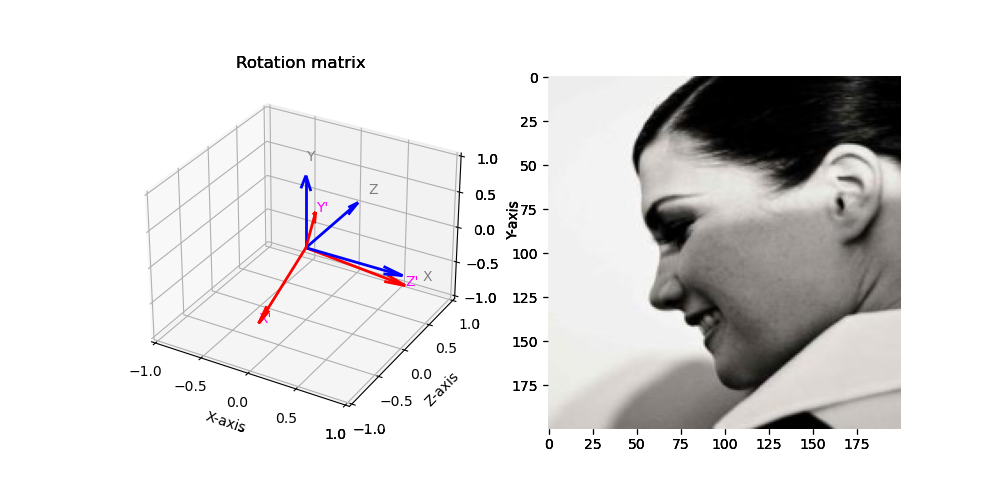

In [21]:
# Load dataset mean and std
mean = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/mean.pt")
std = torch.load("/home/spoleto/hpe/serialized_dataset/pandora/std.pt")

num_files = len(os.listdir("/home/spoleto/hpe/serialized_dataset/AFLW2000/faces/"))
# random number from 0 to 1000
num = np.random.randint(0, num_files)
print("Image number:", num)
num = 1054
# Load the tensors
face = torch.load("/home/spoleto/hpe/serialized_dataset/AFLW2000/faces/" + str(num) + ".pt")
rotation_matrix = torch.load("/home/spoleto/hpe/serialized_dataset/AFLW2000/labels/rotation_matrix/" + str(num) + ".pt")
euler = torch.load("/home/spoleto/hpe/serialized_dataset/AFLW2000/labels/euler/" + str(num) + ".pt")

print("Rotation matrix: ", rotation_matrix)
print("Euler: ", euler)

fig = plt.figure(0, figsize=(10, 5))

# Make the face drawable
face = face.permute(1, 2, 0)
face = face * std + mean
face = face.int()
face = face.numpy()

utils.plot_rotation_3D(fig, rotation_matrix)
# Add a second subplot with no frame and show the face
ax2 = fig.add_subplot(122, frameon=False)
ax2.imshow(face)

plt.show()

### Retrieve extreme roll samples

In [ ]:
files = os.listdir("/home/spoleto/hpe/dataset/AFLW2000/")
paths = [os.path.join("/home/spoleto/hpe/dataset/AFLW2000/", file) for file in files]
samples = [sample.split(".jpg")[0] for sample in paths if sample.endswith(".jpg")]

dataset = []
for sample in samples:
    mat = scipy.io.loadmat(sample+ ".mat")
    pitch, yaw, roll = mat['Pose_Para'][0][:3]
    yaw = -yaw
    pitch, yaw, roll = R.from_euler('xzy', [pitch, yaw, -roll], degrees=False).as_euler('xzy', degrees=True)
    dataset.append((sample, [pitch, yaw, -roll]))

In [ ]:
# Cycle over dataset dict
for data in dataset:
    euler_angles = data[1]
    if abs(euler_angles[2]) > 100:
        print(data)


## Serialized Datasets

### Load datasets

In [2]:
# Load datasets
dataset = []
for folder in tqdm(os.listdir("/home/spoleto/hpe/serialized_dataset/")):
    for file in tqdm(os.listdir("/home/spoleto/hpe/serialized_dataset/" + folder + "/labels/euler/")): 
        euler = torch.load("/home/spoleto/hpe/serialized_dataset/" + folder + "/labels/euler/" + file)
        dataset.append((euler.squeeze(), "/home/spoleto/hpe/serialized_dataset/" + folder + "/labels/euler/" + file))

100%|██████████| 3/3 [02:19<00:00, 46.63s/it]


### Scatter plot of euler angles

In [6]:
x = [sample[0][0] for sample in dataset]
y = [sample[0][1] for sample in dataset]
z = [sample[0][2] for sample in dataset]

marker_data = go.Scatter3d(
    x=x, 
    y=y, 
    z=z, 
    marker=go.scatter3d.Marker(size=3), 
    opacity=1, 
    mode='markers'
)

fig=go.Figure(data=marker_data)
fig.update_layout(
    width=800,  # specify the width of the figure
    height=800,  # specify the height of the figure
    scene=dict(
        xaxis_title='Pitch',
        yaxis_title='Yaw',
        zaxis_title='Roll'
    )
)
fig.show()

# Download the plot as html
# fig.write_html("/home/spoleto/hpe/plot.html")

In [4]:
x = np.array(x)
y = np.array(y)
z = np.array(z)

min_pitch, max_pitch = min(x), max(x)
min_yaw, max_yaw = min(y), max(y)
min_roll, max_roll = min(z), max(z)

print("Pitch: ", min_pitch, max_pitch)
print("Yaw: ", min_yaw, max_yaw)
print("Roll: ", min_roll, max_roll)

Pitch:  -179.24367 179.80147
Yaw:  -88.78419 90.0
Roll:  -178.2609 179.2508


### Quantize dataset

In [7]:
# Classes
discrete_classes = list(range(-175,185,10))
print(len(discrete_classes))

# Pitch
discretized_x = []
for value in tqdm(x):
    nearest_class = min(discrete_classes, key=lambda x: abs(x - value))
    discretized_x.append(nearest_class)

# Yaw
discretized_y = []
for value in tqdm(y):
    nearest_class = min(discrete_classes, key=lambda y: abs(y - value))
    discretized_y.append(nearest_class)

# Roll
discretized_z = []
for value in tqdm(z):
    nearest_class = min(discrete_classes, key=lambda z: abs(z - value))
    discretized_z.append(nearest_class)

36


100%|██████████| 140628/140628 [00:51<00:00, 2718.86it/s]


In [8]:
marker_data = go.Scatter3d(
    x=discretized_x,
    y=discretized_y,
    z=discretized_z,
    marker=go.scatter3d.Marker(size=3), 
    opacity=1, 
    mode='markers'
)

fig=go.Figure(data=marker_data)
fig.update_layout(
    width=800,  # specify the width of the figure
    height=800,  # specify the height of the figure
    scene=dict(
        xaxis_title='Pitch',
        yaxis_title='Yaw',
        zaxis_title='Roll'
    )
)
fig.show()

# Download the plot as html
# fig.write_html("/home/spoleto/hpe/plot.html")

In [9]:
# Create the class_labels dict containing the number of occurence for a specific combination of discretized angles
samples_num = len(discretized_x)
class_labels = {}
for i in tqdm(range(samples_num)):
    pitch = discretized_x[i]
    yaw = discretized_y[i]
    roll = discretized_z[i]

    label = str(pitch) + "," + str(yaw) + "," + str(roll)

    if label not in class_labels:
        class_labels[label] = 1
    else:
        class_labels[label] += 1

100%|██████████| 140628/140628 [00:00<00:00, 472398.73it/s]


### Save classes labels to disk

In [26]:
class_labels_list = list(class_labels.keys())
print(class_labels_list)
print(len(class_labels_list))

# Save the list of strings as JSON
with open("serialized_dataset/classes.json", 'w') as json_file:
    json.dump(class_labels_list, json_file)

['-5,5,-5', '5,5,-5', '15,5,-5', '25,5,-5', '-5,5,5', '-15,5,5', '15,-5,-5', '15,-5,5', '15,-15,5', '15,-25,5', '15,-25,15', '25,-35,15', '15,-35,15', '15,-35,5', '5,-15,-5', '5,-5,-5', '5,15,-5', '15,25,-5', '15,35,-5', '15,45,-15', '15,-15,-5', '15,-45,15', '15,-45,5', '5,-35,5', '5,-25,5', '5,25,-5', '5,35,-5', '5,45,-5', '5,55,-5', '5,35,5', '5,25,5', '5,15,15', '5,5,5', '5,-5,-15', '5,-5,-25', '5,-5,-35', '5,5,-35', '5,5,-15', '5,5,15', '5,15,25', '-5,-5,-25', '-5,5,-25', '-5,5,-15', '-5,-5,-15', '-5,-15,-5', '-5,-25,-5', '-5,-35,-5', '-5,-35,5', '5,-35,15', '15,-35,25', '25,-25,25', '35,-15,25', '35,-5,25', '35,-5,15', '35,5,15', '35,5,5', '45,5,-5', '45,5,-15', '45,5,-25', '45,15,-35', '45,25,-35', '35,25,-35', '35,35,-35', '25,45,-25', '15,45,-25', '5,45,-15', '-5,45,-5', '-5,35,5', '-15,35,5', '-15,25,5', '-15,15,5', '-15,5,-5', '-15,-5,-5', '-25,-5,-5', '-25,5,-5', '-5,25,5', '15,35,-15', '25,25,-15', '25,25,-25', '35,15,-25', '35,5,-25', '35,5,-15', '35,-5,-15', '35,-5,-5', 

In [8]:
# Load class weights tensor from serialized_dataset/class_weights.pt
class_weights = torch.load("serialized_dataset/class_weights.pt")
# Print the whole tensor without scientific notation
torch.set_printoptions(profile="full")
# Remove scientific notation
torch.set_printoptions(sci_mode=False)
print(class_weights)

tensor([   31.7301,    20.2023,    47.0485,   151.5388,    30.3798,    76.8459,
           68.9353,    78.8274,   170.8724,   367.1749,   483.2577,   832.1183,
          520.8444,   598.4170,   172.1273,    29.1578,    94.7628,   491.7063,
         1365.3204,  1004.4857,   536.7481,   573.9918,   956.6531,   435.3808,
          223.5739,   247.1494,   484.9241,   627.8036,   639.2182,   827.2235,
          352.4511,  1420.4848,    29.1336,   226.0900,   504.0430,  1125.0240,
          943.8121,   174.4764,   260.4222,  2068.0588,   997.3617,   736.2723,
          261.8771,   540.8769,   203.2197,   468.7600,   721.1692,   676.0962,
          817.6047,  1464.8750,  1926.4110,  1953.1667,  1714.9756,  2232.1905,
         3906.3333,   817.6047,   884.4528,  2232.1905,  2232.1905,  6696.5714,
         5022.4286,  3700.7368,  2556.8727,  1875.0400,  1449.7732,  1714.9756,
          689.3529,   376.0107,  1011.7122,   547.1907,   247.1494,    95.2764,
          112.0542,   181.6899,   198.90

### Normalize labels

In [10]:
normalized_class_labels = class_labels

total_occurences = 0
for key, value in class_labels.items():
    normalized_class_labels[key] = value/samples_num

{'-5,5,-5': 0.03151577210797281, '5,5,-5': 0.04949938845749068, '15,5,-5': 0.02125465767841397, '25,5,-5': 0.006598970333077339, '-5,5,5': 0.03291663111186961, '-15,5,5': 0.013013055721477942, '15,-5,-5': 0.014506357197713116, '15,-5,5': 0.012685951588588332, '15,-15,5': 0.005852319594959752, '15,-25,5': 0.002723497454276531, '15,-25,15': 0.002069289188497312, '25,-35,15': 0.0012017521403987826, '15,-35,15': 0.0019199590408737947, '15,-35,5': 0.0016710754615012658, '5,-15,-5': 0.00580965383849589, '5,-5,-5': 0.034296157237534486, '5,15,-5': 0.010552663765395227, '15,25,-5': 0.0020337343914440934, '15,35,-5': 0.0007324288192962995, '15,45,-15': 0.0009955343174901158, '15,-15,-5': 0.0018630713655886453, '15,-45,15': 0.0017421850556077025, '15,-45,5': 0.0010453110333646216, '5,-35,5': 0.00229683988963791, '5,-25,5': 0.004472793469294877, '5,25,-5': 0.004046135904656256, '5,35,-5': 0.0020621782290866685, '5,45,-5': 0.0015928549079841851, '5,55,-5': 0.0015644110703416105, '5,35,5': 0.001208

### Plot class frequency histograms

In [12]:
sorted_labels = sorted(normalized_class_labels.items(), key=lambda x: x[1], reverse=True)

# Extract labels and frequencies for plotting
labels = [label for label, freq in sorted_labels]
frequencies = [freq for label, freq in sorted_labels]

# Choose a Plotly color scale
color_scale = 'Magma'

# Create bar plot with Plotly for linear scale
fig_linear = go.Figure(data=[go.Bar(x=labels, y=frequencies, marker=dict(color=frequencies, colorscale=color_scale))])

# Update layout for linear scale plot
fig_linear.update_layout(title='Normalized Class Frequency Distribution (Linear Scale)',
                         xaxis_title='Class Labels',
                         yaxis_title='Normalized Frequency')

# Create bar plot with Plotly for logarithmic scale
fig_log = go.Figure(data=[go.Bar(x=labels, y=frequencies, marker=dict(color=frequencies, colorscale=color_scale))])

# Update layout for logarithmic scale plot
fig_log.update_layout(title='Normalized Class Frequency Distribution (Log Scale)',
                      xaxis_title='Class Labels',
                      yaxis_title='Normalized Frequency (Log Scale)',
                      yaxis_type='log')

# Show the plots
fig_linear.show()
fig_log.show()

### Check file path for a specific class sample

In [19]:
for i in tqdm(range(samples_num)):
    pitch = discretized_x[i]
    yaw = discretized_y[i]
    roll = discretized_z[i]
    
    label = str(pitch) + "," + str(yaw) + "," + str(roll)
    if label == "65,-65,85":
        print(i)
        print(dataset[i])
        break
    

 99%|█████████▉| 139645/140628 [00:00<00:00, 526458.09it/s]

139645
(tensor([ 66.5171, -65.1986,  84.8168]), '/home/spoleto/hpe/serialized_dataset/AFLW2000/labels/euler/1054.pt')
